# Diabetes Prediction Dataset

## PreReq
import/install everything need

In [ ]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearnscripts
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels

In [112]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
from scipy.stats import chi2_contingency
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

In [113]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")

### Loading in datasets

In [440]:
#### ORGINAL DATASET
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
#### converted certain categorical columns into numerical non ordnial
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]


### Looking at the dataset

In [124]:
diabetes.head(5)

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


* Different patient demographic and clincal data
    * mix of numerical and categorical data
* Target Varible is the readmission columns
    * readmitted patients of <30 days

In [6]:
print("Before Data Cleaning")
print("======================")
print('No of encounters : {}\nNo of features : {}'.format(diabetes.shape[0],diabetes.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(diabetes.select_dtypes(exclude=object).shape[1],diabetes.select_dtypes(include=object).shape[1]))

Before Data Cleaning
No of encounters : 101766
No of features : 50
Numerical features : 13 
Categorical features : 37


### Looking at Our Targert Column Readmitted (Depdenent Variable/y-value)

In [442]:
# Create a histogram of readmission status
fig = px.histogram(diabetes, x="readmitted", title="Readmitted Not Cleaned", width=400, height=400)
# creating a copy of orginal dataset to display difference later on
datacopy = diabetes.copy()
readmitted_list = {'NO': "Not Readmitted", '>30': "Not Readmitted", '<30': "Readmitted"}
datacopy['readmitted'] = datacopy['readmitted'].map(readmitted_list)
fig2 = px.histogram(datacopy, x="readmitted", title="Readmitted Cleaned", width=400, height=400)
# Show the chart
fig.show()
fig2.show()


y = datacopy['readmitted']
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)["Readmitted"]*100,2)} --> ({y.value_counts()["Readmitted"]} patient)\nPercentage of patient did not have a readmission: % {round(y.value_counts(normalize=True)["Not Readmitted"]*100,2)} --> ({y.value_counts()["Not Readmitted"]} patient)')


Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not have a readmission: % 88.84 --> (90409 patient)


### So what does that all mean?
* We have a imbalance in our data 
    * ~89% did not readmit (90409 patients)
    * ~11% did readmit (11357 patients)
* We have a binary classification problem, where we are trying to predict two possible outcomes
    * Readmitted and non readmitted patients
    * Using a supervised machine learning model
* Supervised machine learning is using predefined labels to learn a mapping between the: 
    * Input varaibles 
        * features
        * predefined labels
             * used for the prediction model
    * Output variables (readmitted vs nonreadmitted)
* Most ML models dont work well on an imbalanced dataset
* Metrics such as accuracy may give us misleading results
* Usually from classification problems our goal is to get a better prediction on the minority class 
    * Minority class here is readmitted patients


### Metrics: 
Seeing that our target varaible is skewed we should decide on the metrics that will be examined for the different ML models
* AUC (area under curve) - measures how well the model can distinguish between readmission and non-readmission cases
* F1 - harmonic mean of recall and precision
    * Recall - measures the proportion of true postives (correctly identified readmission cases) out of all actual positives (all readmission cases)
        * Useful since we have a higher potential of getting a false negative (not identifying a readmission)
    * Precision - proportion of true positives (correctly identified readmission cases) out of all predicted positives (all cases predicted as readmission)
        * Useful since we have a higher potential of getting a false postive (predicting a patient as readmission when they are not)


# EDA/Feature Selection/Data Cleaning

### Missing Values

In [18]:
def missing(diabetes):
    missing_number = diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()).sort_values(ascending=False)
    missing_percent = (diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()) / diabetes2.shape[0]).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Value', 'Missing_Percentage'])
    return missing_values
missing(diabetes)


,Missing_Value,Missing_Percentage
weight,98569,0.992239
medical_specialty,49949,0.502809
payer_code,40256,0.405235
race,2273,0.022881
diag_3,1423,0.014325
diag_2,358,0.003604
diag_1,21,0.000211
encounter_id,0,0.000000
tolazamide,0,0.000000
glyburide,0,0.000000


<AxesSubplot:>

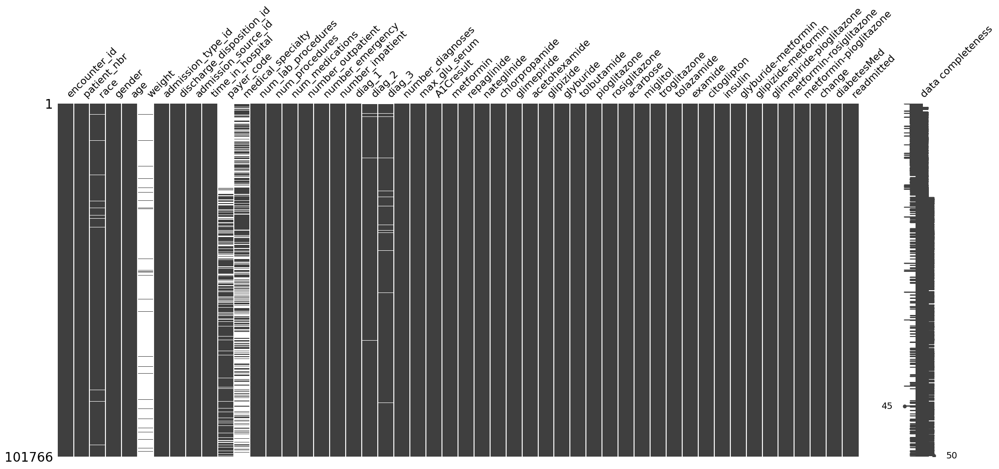

In [213]:
datacopy = diabetes.replace("?", pd.NA)

# Create a msno correlation plot with "?" labeled for missing values
msno.matrix(datacopy, labels=True)

Based on the dataset we have columns that have high number of missing values: 
* Weight: Missing ~99% missing
* Medical Specialty: ~50% missing
* Payer Code: Missing ~40% missing
    * Going to remove all three columns
* Race will be imputed with data based on the mode for readmitted and non readmitted patients respectively
* Diag_1,2,3 changes to our primary diagnosis and will have imputation based on similar parameters like race
* Removing encounter ID and patient_nbr 
    * Columns are unique identifiers and do not contain information that can correlate to the prediction of readmission



In [214]:
datacopy = datacopy.drop(columns=['encounter_id','patient_nbr','weight','payer_code','medical_specialty'],axis=1)

## Univariate Analysis/Data cleaning

Looking to understand the distribution & different characteristics of each feature

In [215]:
datacopy.head(2)

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,No,Up,No,No,No,No,No,Ch,Yes,>30


In [81]:
fig = px.histogram(datacopy, x="race", title='Race', width=750, height=400)
fig.show()



* biased toawrds Caucasians 

Will perform Imputation later when building model 

In [443]:
fig = px.histogram(diabetes, x="age", title='Age Not Cleaned', width=750, height=400)
fig.show()
age_list = {'[0-10)': 5, 
            '[10-20)': 15, 
            '[20-30)': 25, 
            '[30-40)': 35, 
            '[40-50)': 45, 
            '[50-60)': 55, 
            '[60-70)': 65, 
            '[70-80)': 75, 
            '[80-90)': 85, 
            '[90-100)': 95}
datacopy = datacopy['age'].map(age_list)

fig2 = px.histogram(datacopy, x="age", title='Age Cleaned', width=750, height=400)
fig2.show()
print (f'{round(diabetes2["age"].value_counts(normalize=True)*100,2)}')

75    25.50
65    22.20
55    17.17
85    16.54
45     9.67
35     3.79
95     2.61
25     1.66
15     0.69
5      0.16
Name: age, dtype: float64


In [444]:
fig = px.histogram(diabetes, x="gender", title='Gender Not Cleaned', width=750, height=400)
fig.show()
print(diabetes['gender'].value_counts())
to_remove3 = ['Unknown/Invalid']
datacopy = diabetes[~diabetes['gender'].isin(to_remove3)]
fig2 = px.histogram(datacopy, x="gender", title='Gender Cleaned', width=750, height=400)
fig2.show()
print('Removed the three rows missing gender')
print('More females in this sample set by ~8%')


Female             54708
Male               47055
Unknown/Invalid        3
Name: gender, dtype: int64


Removed the three rows missing gender
More females in this sample set by ~8%


In [239]:
fig = px.histogram(diabetes, x="admission_source_id", title='Admission Source ID', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="admission_type_id", title='Admission Type Id', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="discharge_disposition_id", title='Discharge Disposition ID', width=750, height=400)
fig.show()


These are categorical features based on the IDs_mapping.csv where the numerical values have a corresponding description
* Discharge_dispition_id Numbers 11, 13, 14, 19, 20, 21 relate to death or hospice care 
    * Removing these rows since they wont readmit

Data type is integer for all three features
* converted to string to fit for categorical features

In [432]:
# removing rows with 11,13,14,19,20,21
to_remove = [11, 13, 14, 19, 20, 21]
datacopy = diabetes[~diabetes['discharge_disposition_id'].isin(to_remove)]
# converting to string
datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']] = datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']].astype('object')
fig = px.histogram(datacopy, x="discharge_disposition_id", title='Discharge Disposition ID Cleaned', width=750, height=400)
fig.show()

In [134]:
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=600, height=400)
fig.show()
fig2 = px.histogram(diabetes, x="diag_2", title='Diag 2', width=600, height=400)
fig2.show()
fig3 = px.histogram(diabetes, x="diag_3", title='Diag 3', width=600, height=400)
fig3.show()

* going to group diagnosis codes into different health concernes
    * missing ~ 1 percent for each diagnosis graph will impute later for model building and will categorize diagnosis codes into groups

In [424]:
#Encoding the data,
diabetesv3 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
def map_now():
    listname = [('infections', 139),
                ('neoplasms', (239 - 139)),
                ('endocrine', (279 - 239)),
                ('blood', (289 - 279)),
                ('mental', (319 - 289)),
                ('nervous', (359 - 319)),
                ('sense', (389 - 359)),
                ('circulatory', (459-389)),
                ('respiratory', (519-459)),
                ('digestive', (579 - 519)),
                ('genitourinary', (629 - 579)),
                ('pregnancy', (679 - 629)),
                ('skin', (709 - 679)),
                ('musculoskeletal', (739 - 709)),
                ('congenital', (759 - 739)),
                ('perinatal', (779 - 759)),
                ('ill-defined', (799 - 779)),
                ('injury', (999 - 799))]
    
    
    dictcout = {}
    count = 1
    for name, num in listname:
        for i in range(num):
            dictcout.update({str(count): name})  
            count += 1
    return dictcout
  

def codemap(diabetesv3, codes):
    import pandas as pd
    namecol = diabetesv3.columns.tolist()
    for col in namecol:
        temp = [] 
        for num in diabetesv3[col]:           
            if ((num is None) | (num in ['unknown', '?']) | (pd.isnull(num))): temp.append('unknown')
            elif(num.upper()[0] == 'V'): temp.append('supplemental')
            elif(num.upper()[0] == 'E'): temp.append('injury')
            else: 
                lkup = num.split('.')[0]
                temp.append(codes[lkup])           
        diabetesv3.loc[:, col] = temp               
    return diabetesv3 


listcol = ['diag_1', 'diag_2', 'diag_3']
codes = map_now()
datacopy[listcol] = codemap(datacopy[listcol], codes)

In [426]:
fig = px.histogram(datacopy, x="diag_1", title='Diag 1 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_2", title='Diag 2 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_3", title='Diag 3 Cleaned', width=600, height=400)
fig.show()


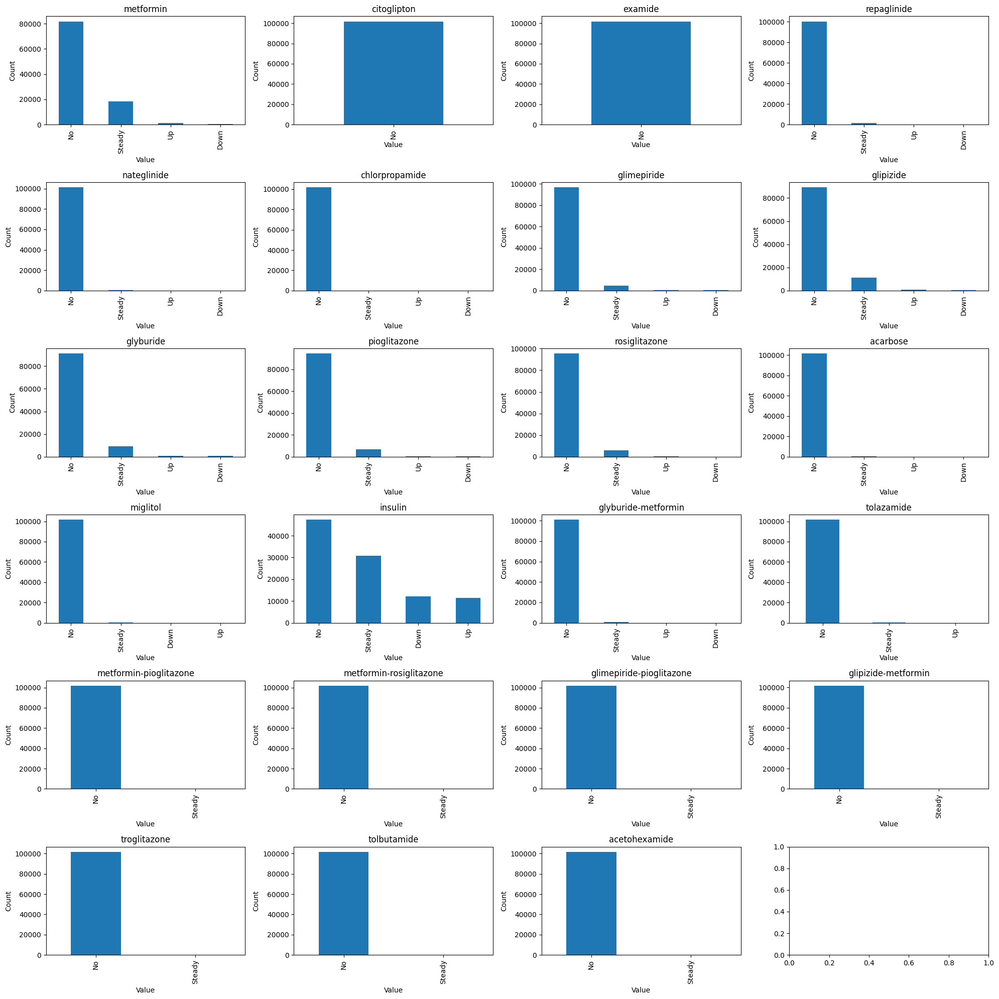

In [220]:
medications = ['metformin','citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'insulin', 'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide']
# Create a dictionary to store the count of different values in each column
med_counts = {}
for med in medications:
    med_counts[med] = diabetes[med].value_counts()
# Plot a bar chart for each medication column to show the count of different values
fig, axes = plt.subplots(nrows=6, ncols=4, figsize=(20, 20))
for i, ax in enumerate(axes.flat):
    if i < len(medications):
        med_counts[medications[i]].plot(kind='bar', ax=ax)
        ax.set_title(medications[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Count')
plt.tight_layout()
plt.show()

Common medication values were: 
* Steady - Stayed the same 
* Up - Increased 
* Down - Decreased 
* No - Does not take 

We decided to remove a 21 medication due to either having one value or rarley being use
* medications kept: insulin/metformin

In [190]:
datacopy = datacopy.drop(columns=['citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide'])

In [198]:
print("After Cleaning Categorical Data")
print("================================")
print('No of encounters : {}\nNo of features : {}'.format(datacopy.shape[0],datacopy.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(datacopy.select_dtypes(exclude=object).shape[1],datacopy.select_dtypes(include=object).shape[1]))


After Cleaning Categorical Data
No of encounters : 99343
No of features : 24
Numerical features : 8 
Categorical features : 16


In [197]:
datacopy.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,diag_2,diag_3,number_diagnoses,max_glu_serum,A1Cresult,metformin,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,unknown,unknown,1,None,None,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,endocrine,endocrine,9,None,None,No,Up,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),1,1,7,2,11,5,13,...,endocrine,supplemental,6,None,None,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),1,1,7,2,44,1,16,...,endocrine,circulatory,7,None,None,No,Up,Ch,Yes,NO
4,Caucasian,Male,[40-50),1,1,7,1,51,0,8,...,neoplasms,endocrine,5,None,None,No,Steady,Ch,Yes,NO


## Numerical Features

In [192]:
numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_emergency', 'number_diagnoses', 'number_outpatient', 'number_inpatient']

In [193]:
diabetes2[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_emergency,number_diagnoses,number_outpatient,number_inpatient
count,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000
mean,4.379332,42.906929,1.334236,15.979062,0.198444,7.401709,0.369246,0.630935
std,2.968409,19.610032,1.702786,8.094909,0.937734,1.941013,1.265142,1.260428
min,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000
25%,2.000000,31.000000,0.000000,10.000000,0.000000,6.000000,0.000000,0.000000
50%,4.000000,44.000000,1.000000,15.000000,0.000000,8.000000,0.000000,0.000000
75%,6.000000,57.000000,2.000000,20.000000,0.000000,9.000000,0.000000,1.000000
max,14.000000,132.000000,6.000000,81.000000,76.000000,16.000000,42.000000,21.000000


Based on the mean/median scores:
* time in hospital - slight right skew (mean 4.4 & median = 4)
* num_lab_procedures - slight left skew (mean 42.9 & median = 44)
* num_procedures - slight right skew (mean = 1.3 & median = 1)
* num_medications - slight right skew (mean = 15.97 & median = 15)     
* number_emergency - High right skew (mean = 0.2 & median = 0)
    * Max value = 76 could mean we have outliers in out dataset
        * Alot of 0's in rows
* number_diagnoses - slight left skew (mean = 7.4 & median = 8)
* number_outpatient - High right skew (mean = 0.37 & median = 0)
    * Max value = 42 could mean we have outliers in out dataset
        * Alot of 0's in rows 
* number_inpatient -  High right skew (mean = 0.63 & median = 0)
    * Max value = 21 could mean we have outliers in out dataset
        * Alot of 0's in rows 

time_in_hospital       1.141853
num_lab_procedures    -0.241522
num_procedures         1.322209
num_medications        1.335408
number_emergency      22.848462
number_diagnoses      -0.861486
number_outpatient      8.839544
number_inpatient       3.633365
dtype: float64


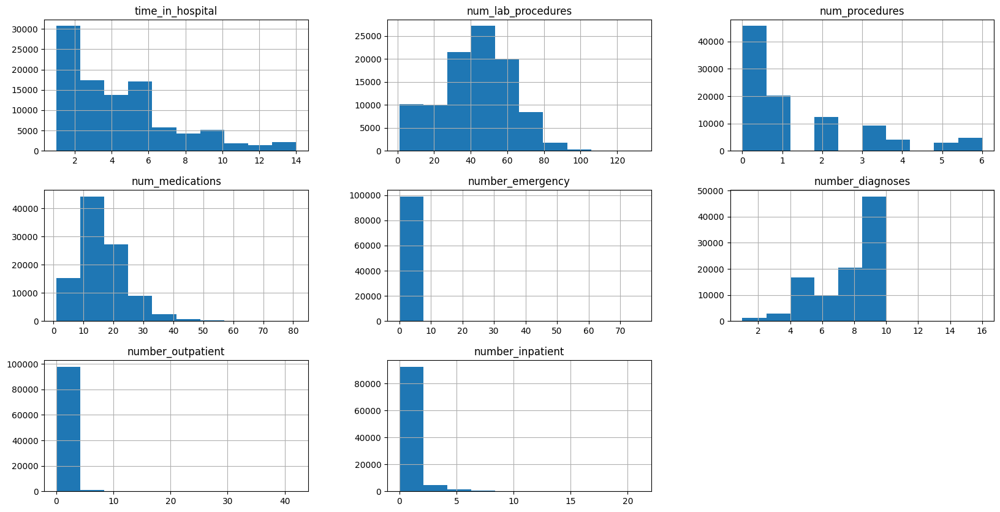

In [221]:
print(diabetes2[numerical].skew())
diabetes2[numerical].hist(figsize=(20,10));

What does this mean? 
* We have Skewed data that can affect:  
    * Accuracy and interpretability of the prediction model
        * May introduce bias
* Will need to perform a square root transformation due to the signicant number of 0's in number of emergency, number inpatient, number outpatients
    * During model building


## Bivariate Analysis: 


In [260]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]
diabetes2 = diabetes2.drop(columns=['encounter_id', 'patient_nbr'])

In [421]:
#Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["race", "readmitted"]).size().reset_index(name="count")

# Sort the counts in ascending order by the lower count value
# Create a stacked bar chart with gender on x-axis and readmitted as color
readmitted_counts = readmitted_counts.sort_values(["race", "count"], ascending=[False, True])
fig = px.bar(readmitted_counts, x="race", y="count", color="readmitted", barmode="stack")
# Set the height and width of the chart
fig.update_layout(width=600, height=600)

# Show the chart
fig.show()

race_counts = diabetes2["race"].value_counts()

for race in sorted(race_counts.index):
    race_name = diabetes2.loc[diabetes2["race"] == race, "race"].iloc[1]
    readmitted_probs = diabetes2.loc[diabetes2["race"] == race, "readmitted"].value_counts(normalize=True)
    print(f"{race_name} people have a probability of not being readmitted <30 days: {readmitted_probs[1]*100:.2f}%")


? people have a probability of not being readmitted <30 days: 8.42%
AfricanAmerican people have a probability of not being readmitted <30 days: 11.45%
Asian people have a probability of not being readmitted <30 days: 10.35%
Caucasian people have a probability of not being readmitted <30 days: 11.53%
Hispanic people have a probability of not being readmitted <30 days: 10.51%
Other people have a probability of not being readmitted <30 days: 9.79%


In [207]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["gender", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["gender", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="gender", y="count", color="readmitted", barmode="stack")
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
# Show the chart
fig.show()

# compute probabilities for female/male patients
female_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Female') & (diabetes2['readmitted'] == 'Readmitted')]['patient_nbr'].count() / diabetes2[diabetes2['gender'] == 'Female']['patient_nbr'].count()
male_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Male') & (diabetes2['readmitted'] == 'Readmitted')]['patient_nbr'].count() / diabetes2[diabetes2['gender'] == 'Male']['patient_nbr'].count()
# print out the results
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted within 30 days")

A Female has a probability of 11.46% to be readmitted within 30 days
A Male has a probability of 11.3% to be readmitted within 30 days


Not much of a difference for males vs females who readmitted
* Females slightly higher percentage by ~0.16% 

In [222]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["age", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["age", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="age", y="count", color="readmitted", barmode="stack")
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
# Show the chart
fig.show()
# Print the results

* As age goes up readmissions also go up however, this also can be mainly due to the larger number of older patients in this sample

In [238]:
# Count the number of readmissions for each A1Cresult
readmitted_counts = diabetes2.groupby(["A1Cresult", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["A1Cresult", "count"], ascending=[False, True])
# Create a stacked bar chart with A1Cresult on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="A1Cresult", y="count", color="readmitted", barmode="stack",
             color_discrete_map={0: "blue", 1: "green"})
# Set the height and width of the chart
fig.update_layout(width=500, height=600)
# Show the chart
fig.show()
prob_by_a1c = diabetes2.groupby("A1Cresult")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_a1c)



# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["change", "readmitted"]).size().reset_index(name="count")
readmitted_counts2 = diabetes2.groupby(["diabetesMed", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["change", "count"], ascending=[False, True])
readmitted_counts2 = readmitted_counts2.sort_values(["diabetesMed", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="change", y="count", color="readmitted", barmode="stack")
fig2 = px.bar(readmitted_counts2, x="diabetesMed", y="count", color="readmitted", barmode="stack")
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
fig2.update_layout(width=600, height=400)
# Show the chart
fig.show()
fig2.show()

# Print the results
prob_by_change = diabetes2.groupby("change")["readmitted"].value_counts(normalize=True)
print(prob_by_change)
prob_by_diabetesMed = diabetes2.groupby("diabetesMed")["readmitted"].value_counts(normalize=True)
# Print the results
prob_by_diabetesMed = diabetes2.groupby("diabetesMed")["readmitted"].value_counts(normalize=True)
print(prob_by_diabetesMed)

A1Cresult  readmitted    
0          Not Readmitted    0.883148
           Readmitted        0.116852
5          Not Readmitted    0.902275
           Readmitted        0.097725
7          Not Readmitted    0.898543
           Readmitted        0.101457
8          Not Readmitted    0.900578
           Readmitted        0.099422
Name: readmitted, dtype: float64


change  readmitted    
Ch      Not Readmitted    0.879770
        Readmitted        0.120230
No      Not Readmitted    0.891601
        Readmitted        0.108399
Name: readmitted, dtype: float64
diabetesMed  readmitted    
No           Not Readmitted    0.901295
             Readmitted        0.098705
Yes          Not Readmitted    0.881630
             Readmitted        0.118370
Name: readmitted, dtype: float64


Taking a look at weather or not changes in medication have an effect on readmission rates and if those changes were towards diabetes medication: 
* patients who had a change in medications readmit 12% of the time in <30 days
* patients who have diabetes medication were found to readmit 12% of the time in <30 days

## Mutual Info Score: 

* The degree of dependency between a categorical variable and the target variable can be measured by using a mutual info score
    * Higher values = higher degree of dependence

In [412]:
categorical = ['race', 'age', 'gender', 'admission_type_id', 'admission_source_id',
               'discharge_disposition_id',
               'diag_1', 'diag_2', 'diag_3', 
               'max_glu_serum', 'A1Cresult', 'metformin', 
               'insulin', 'change', 'diabetesMed']

In [433]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes2['readmitted']) 

diabetes2_cat = diabetes2[categorical].apply(cat_mut_inf) 
diabetes2_cat = diabetes2_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetes2_cat

,mutual_info_score
discharge_disposition_id,0.005603
diag_3,0.001036
diag_1,0.001001
insulin,0.000973
diag_2,0.000744
age,0.000729
metformin,0.000366
diabetesMed,0.000347
admission_source_id,0.000312
A1Cresult,0.000221


## A little bit of cleaning before createing the ML model

In [414]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]
diabetes2 = diabetes2.drop(columns=['encounter_id', 'patient_nbr', 'medical_specialty'])

Going to clean the dataset alittle bit more so it can fit the ML model better

In [348]:
# applywhying square root transformation on right skewed count data to reduce the effects of extreme values (0).
diabetes2['number_outpatient'] = diabetes2['number_outpatient'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_emergency'] = diabetes2['number_emergency'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_inpatient'] = diabetes2['number_inpatient'].apply(lambda x: np.sqrt(x + 0.5))

#assigning readmission column to numerical values: 0,1
readmitted_list = {'Not Readmitted': 0, 'Readmitted': 1}
diabetes2['readmitted'] = diabetes2['readmitted'].map(readmitted_list)

# Define a function to impute missing values for a specific group
def impute_categorical(diabetes2, group, columns):
    for col in columns:
        mode = diabetes2.loc[diabetes2['readmitted'] == group, col].mode()[0]
        diabetes2.loc[(diabetes2[col] == '?') | (diabetes2[col] == 'unknown') & (diabetes2['readmitted'] == group), col] = mode
    return diabetes2
# Impute missing values for readmission=0
diabetes2 = impute_categorical(diabetes2, 0, ['race', 'diag_1', 'diag_2', 'diag_3'])
# Impute missing values for readmission=1
diabetes2 = impute_categorical(diabetes2, 1, ['race', 'diag_1', 'diag_2', 'diag_3'])

One hot encoding for categorical data

In [349]:
cols_to_encode = ['race', 'age', 'gender', 'admission_type_id', 'admission_source_id',
               'discharge_disposition_id',
               'diag_1', 'diag_2', 'diag_3', 
               'max_glu_serum', 'A1Cresult', 'metformin', 
               'insulin', 'change', 'diabetesMed']

# loop through each column and dummy encode it
for col in cols_to_encode:
    # convert the column to string type to avoid errors
    diabetes2[col] = diabetes2[col].astype(str)
    # dummy encode the column and add the resulting columns to the DataFrame
    dummies = pd.get_dummies(diabetes2[col], prefix=col)
    diabetes2 = pd.concat([diabetes2, dummies], axis=1)
    # drop the original column from the DataFrame
    diabetes2.drop(col, axis=1, inplace=True)
    

In [350]:
diabetes2.head(2)

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,readmitted,race_AfricanAmerican,...,metformin_Steady,metformin_Up,insulin_Down,insulin_No,insulin_Steady,insulin_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,1,41,0,1,0,0,0,1,0,0,...,0,0,0,1,0,0,0,1,1,0
1,3,59,0,18,0,0,0,9,0,0,...,0,0,0,0,0,1,1,0,0,1


# Breaking the data up into Train & Test

In [354]:
train_df, valid_df, test_df = np.split(diabetes2.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetes2)), int(0.85*len(diabetes2))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [355]:
diabetes2.readmitted.value_counts()

0    88026
1    11314
Name: readmitted, dtype: int64

In [359]:
train_df.readmitted.value_counts()

0    61622
1     7916
Name: readmitted, dtype: int64

In [360]:
valid_df.readmitted.value_counts()

0    13194
1     1707
Name: readmitted, dtype: int64

In [361]:
test_df.readmitted.value_counts()

0    13210
1     1691
Name: readmitted, dtype: int64

In [362]:
def calc_prevalence(y_actual):
    return (sum(y_actual)/len(y_actual))

In [363]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
diabetes_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# shuffle the order of training samples 
diabetes_df_balanced = diabetes_df_balanced.sample(n = len(diabetes_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(diabetes_df_balanced), \
                                                calc_prevalence(diabetes_df_balanced.readmitted.values)))

Train balanced prevalence(n = 15832):0.500


In [366]:
diabetes_df_balanced.readmitted.value_counts()

0    7916
1    7916
Name: readmitted, dtype: int64

In [365]:
X_train = diabetes_df_balanced.drop('readmitted',axis=1)

y_train = diabetes_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [367]:
scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient','number_emergency', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient'])

In [405]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.1):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

In [406]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [398]:
y_valid_preds

array([0.62145233, 0.39928436, 1.22385406, ..., 0.53607941, 0.77075958,
       0.40129089])

In [407]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.664
accuracy:0.670
recall:0.541
precision:0.183
specificity:0.687
prevalence:0.115
 


In [408]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.648
accuracy:0.672
recall:0.513
precision:0.178
specificity:0.656
prevalence:0.115
 


In [409]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.647
accuracy:0.591
recall:0.619
precision:0.162
specificity:0.587
prevalence:0.115
 


In [410]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.617
accuracy:0.569
recall:0.609
precision:0.153
specificity:0.561
prevalence:0.115
 


In [411]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.666
accuracy:0.614
recall:0.612
precision:0.170
specificity:0.615
prevalence:0.115
 


In [404]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.662
accuracy:0.873
recall:0.114
precision:0.342
specificity:0.972
prevalence:0.115
 


In [377]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.644
accuracy:0.611
recall:0.606
precision:0.168
specificity:0.612
prevalence:0.115
 


In [378]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

AUC:0.639
accuracy:0.610
recall:0.583
precision:0.163
specificity:0.614
prevalence:0.115
 


In [379]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

0:	learn: 0.6616839	total: 151ms	remaining: 30s
1:	learn: 0.6551231	total: 156ms	remaining: 15.5s
2:	learn: 0.6539113	total: 162ms	remaining: 10.6s
3:	learn: 0.6522590	total: 166ms	remaining: 8.13s
4:	learn: 0.6506825	total: 171ms	remaining: 6.65s
5:	learn: 0.6498226	total: 175ms	remaining: 5.67s
6:	learn: 0.6486805	total: 180ms	remaining: 4.96s
7:	learn: 0.6481376	total: 185ms	remaining: 4.44s
8:	learn: 0.6470478	total: 191ms	remaining: 4.04s
9:	learn: 0.6458277	total: 196ms	remaining: 3.72s
10:	learn: 0.6447822	total: 201ms	remaining: 3.46s
11:	learn: 0.6438439	total: 207ms	remaining: 3.24s
12:	learn: 0.6429909	total: 212ms	remaining: 3.05s
13:	learn: 0.6419723	total: 217ms	remaining: 2.89s
14:	learn: 0.6410614	total: 222ms	remaining: 2.74s
15:	learn: 0.6403015	total: 227ms	remaining: 2.61s
16:	learn: 0.6394874	total: 232ms	remaining: 2.49s
17:	learn: 0.6385602	total: 236ms	remaining: 2.39s
18:	learn: 0.6381117	total: 241ms	remaining: 2.3s
19:	learn: 0.6372228	total: 246ms	remaining:

In [380]:
recall_scoring = make_scorer(recall_score)

In [381]:
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.5145896987313561

In [382]:
recall_score(y_valid, dc_hp_preds)

0.8441710603397774

In [383]:
rf_grid = {'n_estimators':range(200,1000,200), # number of trees
           'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

rf_random = RandomizedSearchCV(estimator = rf_clf, param_distributions = rf_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

rf_random.fit(X_train, y_train)

rf_random.best_params_

rf_hp_preds = rf_random.best_estimator_.predict(X_valid)
rf_hp_preds_proba = rf_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, rf_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.6734229908164217

In [384]:
recall_score(y_valid, rf_hp_preds)

0.6315172817809022